In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
plt.rcParams["font.family"] = "Arial"
# from skimage import measure
import pyvista as pv
pv.set_jupyter_backend('trame')
from tqdm import tqdm, trange
from scipy import interpolate, ndimage, fft
from scipy.io import savemat, loadmat
from time import time
from PIL import Image
from scipy.interpolate import splrep, splev


In [2]:
# random seed
np.random.seed(11451419)

## Define function


In [3]:
from Vortex import *

In [4]:
def defect_density(vortex_volume, r_grid):
    d_voxel = r_grid[0][0,1,0]-r_grid[0][0,0,0]
    d_cell = [(r_grid[0][0,-1,0]-r_grid[0][0,0,0]),
              (r_grid[1][-1,0,0]-r_grid[1][0,0,0]),
              (r_grid[2][0,0,-1]-r_grid[2][0,0,0])] 
    sum_voxel = np.sum(vortex_volume) # total volume of defective voxels (pixel^3)
    cross_voxel = 4 # crossection of defective voxels (pixel^2)
    length = sum_voxel/cross_voxel # length of defect line (pixel)

    cell_volume = d_cell[0]*d_cell[1]*d_cell[2]
    line_density = length*d_voxel/cell_volume

    return(line_density)

## Fitting results

In [5]:
'''
30%
d = 64.6432 +- 3.3425
sigma_k = 0.6726% +- 0.1121%
kappa = 3.7827 +- 0.6305
alpha = 0.7027 +- 0.1171
f_AOT = 24.1135% +- 3.6500%


40%
d = 48.9493 +- 2.0980
sigma_k = 0.7797% +- 0.1299%
kappa = 2.6546 +- 0.4424
alpha = 0.4926 +- 0.0821
f_AOT = 31.1141% +- 2.9012%


50%
d = 38.9151 +- 1.7524
sigma_k = 0.2560% +- 0.0427%
kappa = 1.6590 +- 0.2765
alpha = 0.2992 +- 0.0499
f_AOT = 38.2404% +- 1.9021%
'''
wt_list = [30,40,50]
d_list = [64.6432,48.9493,38.9151]
sigma_k_list = [0.6726e-2, 0.7797e-2, 0.2560e-2]
kappa_list = [3.7827, 2.6546, 1.6590]
alpha_list = [0.7027, 0.4926, 0.2992]

In [6]:
## Generate random wave
## Meshgrid
n_grid = 100
x = np.linspace(-1,1,n_grid+1)
y = np.linspace(-1,1,n_grid+1)
z = np.linspace(-1,1,n_grid+1)

r_grid = np.meshgrid(x,y,z) 

color_cycle = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
for i, (sigma_k, kappa, alpha, wt, d) in enumerate(zip(sigma_k_list,kappa_list,alpha_list, wt_list, d_list)):
    #### Wave vector distribution ####
    scale = 1.6/d*100
    k_mean_z = np.array([0,0,scale])*2*np.pi # lamellar perpendicular to z axis 
    # k_mean_x = np.array([0,0,0])*np.pi # lamellar perpendicular to z axis 
    k_var  = (np.array([0,0,sigma_k*scale])*2*np.pi)**2
    k_cov  = np.diagflat(k_var)

    rho = sample_wave_MO_complex(r_grid,k_mean_z,k_cov,n_wave = 100, kappa=kappa)

    n_grid_scale = 200
    scale_zoom = n_grid_scale/rho.shape[0]

    def scale_rho(rho, r_grid, scale):
        rho = ndimage.zoom(rho, scale, order=1)
        r_grid = np.array([ndimage.zoom(r, scale, order=1) for r in r_grid]) 
        return rho, r_grid

    rho, r_grid = scale_rho(rho, r_grid, scale_zoom)

    rho_real = rho.real
    rho_imag = rho.imag
    rho_phase = np.angle(rho)

    vortex_volume = vortex_phase(rho_phase)

    ## defect density
    line_density = defect_density(vortex_volume, r_grid)
    print(line_density/scale**2)

    ## visualize lamellar
    visualize_lamellar(r_grid, rho_real, vortex_volume, 
                       color=color_cycle[i],
                       filename = './Figures/exp_{}_lamellar.png'.format(wt))

    ### Trace defect lines
    array = vortex_volume
    positions_tuple_list, positions_list, adjacent_list, adjacent_id_list = get_adjacency(array)
    poslist_arr = np.array(positions_tuple_list)

    sample, sample_adj_list, sample_adj_dict = get_core(positions_tuple_list, adjacent_id_list, 
                                                    cluster_size=3)
    sample_ordered = get_ordered_points(sample, sample_adj_list)

    sample_ordered_sm = []
    for line in sample_ordered:
        if len(line)>5:
            x = np.arange(len(line))
            arr_line = np.array(line)
            spl_list = [splrep(x,arr_line[:,i],w=np.ones(len(line)),s=len(line)) for i in range(3)]
            line_sm = np.array([splev(x,spl) for spl in spl_list]).T
            sample_ordered_sm.append(line_sm)
        else:
            sample_ordered_sm.append(line)

    visualize_defect(r_grid,rho_real,vortex_volume,sample_ordered_sm,lw=2,
        filename = './Figures/exp_{}_dislocation.png'.format(wt))


100%|██████████| 200/200 [00:00<00:00, 433.72it/s]


1.709221177052772


Widget(value="<iframe src='http://localhost:59102/index.html?ui=P_0x1ca6ccd94f0_0&reconnect=auto' style='width…

Widget(value="<iframe src='http://localhost:59102/index.html?ui=P_0x1ca107899d0_1&reconnect=auto' style='width…

100%|██████████| 200/200 [00:00<00:00, 451.84it/s]


2.2571875551097347


Widget(value="<iframe src='http://localhost:59102/index.html?ui=P_0x1ca1d7a50d0_2&reconnect=auto' style='width…

Widget(value="<iframe src='http://localhost:59102/index.html?ui=P_0x1ca1e9d5490_3&reconnect=auto' style='width…

100%|██████████| 200/200 [00:00<00:00, 400.09it/s]


2.926458956791873


Widget(value="<iframe src='http://localhost:59102/index.html?ui=P_0x1ca1c4f1520_4&reconnect=auto' style='width…

Widget(value="<iframe src='http://localhost:59102/index.html?ui=P_0x1ca0e79a2e0_5&reconnect=auto' style='width…

In [7]:
def generate_rho_phase(r_grid,sigma_k,kappa,alpha):
    #### Wave vector distribution ####
    scale = 3.6
    k_mean_z = np.array([0,0,scale])*2*np.pi # lamellar perpendicular to z axis 
    # k_mean_x = np.array([0,0,0])*np.pi # lamellar perpendicular to z axis 
    k_var  = (np.array([0,0,sigma_k*scale])*2*np.pi)**2
    k_cov  = np.diagflat(k_var)

    rho = sample_wave_MO_complex(r_grid,k_mean_z,k_cov,n_wave = 100, kappa=kappa)

    n_grid_scale = 360
    scale_zoom = n_grid_scale/rho.shape[0]

    def scale_rho(rho, r_grid, scale):
        rho = ndimage.zoom(rho, scale, order=1)
        r_grid = np.array([ndimage.zoom(r, scale, order=1) for r in r_grid]) 
        return rho, r_grid

    rho, r_grid = scale_rho(rho, r_grid, scale_zoom)

    # rho_real = rho.real
    # rho_imag = rho.imag
    rho_phase = np.angle(rho)

    return rho_phase

In [8]:
## Generate random wave
## Meshgrid
n_grid = 144
x = np.linspace(-1,1,n_grid+1)
y = np.linspace(-1,1,n_grid+1)
z = np.linspace(-1,1,n_grid+1)

r_grid = np.meshgrid(x,y,z) 

tangent_list_parameters = []
for i, (sigma_k, kappa, alpha, wt, d) in enumerate(zip(sigma_k_list,kappa_list,alpha_list, wt_list, d_list)):
    ## ODF
    sample_size = 0
    tangent_list = []
    minsize = 20000
    while sample_size < minsize:
        # generate random wave phase
        rho_phase = generate_rho_phase(r_grid,sigma_k,kappa,alpha)
        # identify vortex voxel
        vortex_volume = vortex_phase(rho_phase)
        if np.sum(vortex_volume) == 0:
            print('no defect identified')
            print('sample_size = {}/{} (+ 0)\n'.format(sample_size,minsize))
            continue
        # generate adjacent list
        positions_tuple_list, positions_list, adjacent_list, adjacent_id_list = get_adjacency(vortex_volume)
        poslist_arr = np.array(positions_tuple_list)
        # generate sample points
        sample, sample_adj_list, sample_adj_dict = get_core(positions_tuple_list, adjacent_id_list, 
                                                cluster_size=3)
        # reorder sample points, trace vortex line
        sample_ordered = get_ordered_points(sample, sample_adj_list)

        sample_size_current = np.sum([len(x) for x in sample_ordered])
        sample_size += sample_size_current

        print('sample_size = {}/{} (+ {})\n'.format(sample_size,minsize, sample_size_current))

        # get line tangent
        for line in sample_ordered:
            if len(line)>=7:
                # smooth the line
                x = np.arange(len(line))
                arr_line = np.array(line)
                spl_list = [splrep(x,arr_line[:,i],w=np.ones(len(line)),s=len(line)) for i in range(3)]
                line_sm = np.array([splev(x,spl) for spl in spl_list]).T

                tangent = get_tangent(line_sm)
                tangent_list.extend(tangent[3:-3])

    tangent_list_parameters.append(tangent_list)

100%|██████████| 360/360 [00:02<00:00, 138.12it/s]


sample_size = 10341/20000 (+ 10341)



100%|██████████| 360/360 [00:02<00:00, 134.37it/s]


sample_size = 20504/20000 (+ 10163)



100%|██████████| 360/360 [00:02<00:00, 129.56it/s]


sample_size = 16656/20000 (+ 16656)



100%|██████████| 360/360 [00:02<00:00, 139.06it/s]


sample_size = 31844/20000 (+ 15188)



100%|██████████| 360/360 [00:02<00:00, 137.01it/s]


sample_size = 18915/20000 (+ 18915)



100%|██████████| 360/360 [00:02<00:00, 136.89it/s]


sample_size = 38466/20000 (+ 19551)



In [9]:
for i, (sigma_k, kappa, alpha, wt, d) in enumerate(zip(sigma_k_list,kappa_list,alpha_list, wt_list, d_list)):
    tangent = tangent_list_parameters[i]
    phi = [np.arccos(np.abs(t[2])) for t in tangent]

    filename = './mat/line_exp_{}.mat'.format(wt)
    print(filename)
    mdic = {'tangent':tangent, 'phi':phi,}
    savemat(filename,mdic)

./mat/line_exp_30.mat
./mat/line_exp_40.mat
./mat/line_exp_50.mat


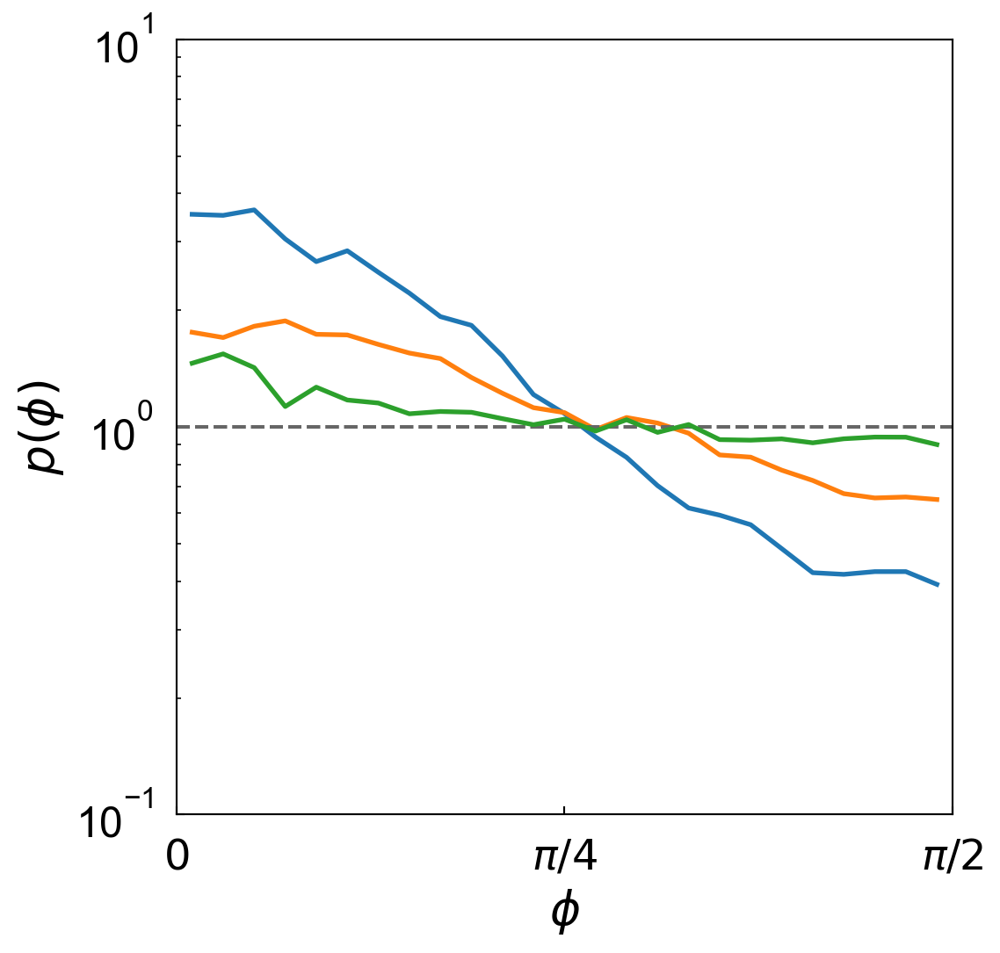

In [10]:
fig = plt.figure(figsize=(6,6),dpi=192)
ax = fig.add_subplot(1, 1, 1)

linestyle = ['-','--',':']
linecolor = ['C0', 'C1', 'C2']
i = 0

for i, (sigma_k, kappa, alpha, wt, d) in enumerate(zip(sigma_k_list,kappa_list,alpha_list, wt_list, d_list)):
    # ax = fig.add_subplot(1, 3, i+1)
    # print(int(7-i+(i%3)*2))

    filename = './mat/backup/line_exp_{}.mat'.format(wt)
    data = loadmat(filename)

    phi = data['phi'][0]

    n_bins = 25
    d_bins = 1/n_bins*np.pi/2
    counts, bins = np.histogram(phi, bins=np.arange(n_bins+1)*d_bins)
    ax.plot([0, np.pi/2],[1,1],'--',color='#666666')
    ax.plot(bins[1:]-d_bins/2,counts/np.sum(counts)/np.sin(bins[1:]-d_bins/2)/d_bins, 
            '-', lw=2, color=linecolor[i])

    ax.set_yscale('log')
    ax.set_xlim([0, np.pi/2])
    ax.set_ylim([1/10, 10])
    ax.set_xticks([0, np.pi/4, np.pi/2])
    ax.set_yticks([1e-1, 1, 1e1])
    ax.set_xticklabels(['$0$', '$\pi/4$', '$\pi/2$'])

    if sigma_k==0:
        ax.set_xlabel('$\phi$',fontsize=20)
    if kappa==256:
        ax.set_ylabel('$p(\phi)$',fontsize=20)
    ax.tick_params(direction='in', axis='both', which='both', labelsize=18, pad=10)
    ax.set_aspect(np.pi/2/(np.log10(10**2))) # x/y

ax.set_xlabel('$\phi$',fontsize=20)
ax.set_ylabel('$p(\phi)$',fontsize=20)
# plt.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()

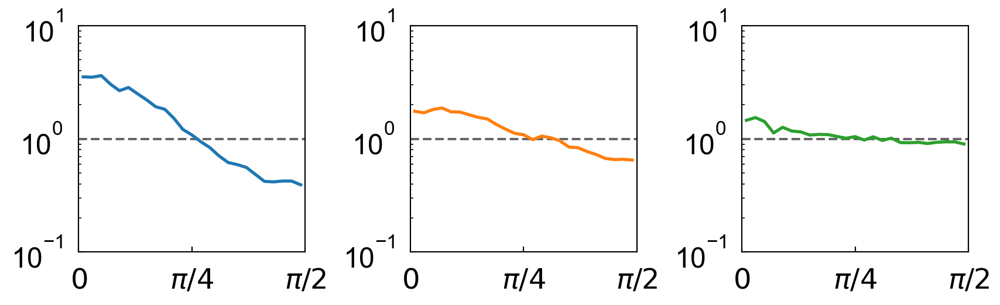

ERROR:asyncio:Task exception was never retrieved
future: <Task finished name='Task-10' coro=<RequestHandler.start() done, defined at c:\Users\wagen\anaconda3\envs\tf-gpu\lib\site-packages\aiohttp\web_protocol.py:462> exception=AssertionError()>
Traceback (most recent call last):
  File "c:\Users\wagen\anaconda3\envs\tf-gpu\lib\asyncio\tasks.py", line 256, in __step
    result = coro.send(None)
  File "c:\Users\wagen\anaconda3\envs\tf-gpu\lib\site-packages\aiohttp\web_protocol.py", line 505, in start
    request = self._request_factory(message, payload, self, writer, handler)
  File "c:\Users\wagen\anaconda3\envs\tf-gpu\lib\site-packages\aiohttp\web_app.py", line 446, in _make_request
    return _cls(
  File "c:\Users\wagen\anaconda3\envs\tf-gpu\lib\site-packages\aiohttp\web_request.py", line 811, in __init__
    super().__init__(*args, **kwargs)
  File "c:\Users\wagen\anaconda3\envs\tf-gpu\lib\site-packages\aiohttp\web_request.py", line 188, in __init__
    assert transport is not None

In [ ]:
fig = plt.figure(figsize=(9,3),dpi=192)
# ax = fig.add_subplot(1, 1, 1)

linestyle = ['-','--',':']
linecolor = ['C0', 'C1', 'C2']
i = 0

for i, (sigma_k, kappa, alpha, wt, d) in enumerate(zip(sigma_k_list,kappa_list,alpha_list, wt_list, d_list)):
    ax = fig.add_subplot(1, 3, i+1)
    # print(int(7-i+(i%3)*2))

    filename = './mat/backup/line_exp_{}.mat'.format(wt)
    data = loadmat(filename)

    phi = data['phi'][0]

    n_bins = 25
    d_bins = 1/n_bins*np.pi/2
    counts, bins = np.histogram(phi, bins=np.arange(n_bins+1)*d_bins)
    ax.plot([0, np.pi/2],[1,1],'--',color='#666666')
    ax.plot(bins[1:]-d_bins/2,counts/np.sum(counts)/np.sin(bins[1:]-d_bins/2)/d_bins, 
            '-', lw=2, color=linecolor[i])

    ax.set_yscale('log')
    ax.set_xlim([0, np.pi/2])
    ax.set_ylim([1/10, 10])
    ax.set_xticks([0, np.pi/4, np.pi/2])
    ax.set_yticks([1e-1, 1, 1e1])
    ax.set_xticklabels(['$0$', '$\pi/4$', '$\pi/2$'])

    if sigma_k==0:
        ax.set_xlabel('$\phi$',fontsize=20)
    if kappa==256:
        ax.set_ylabel('$p(\phi)$',fontsize=20)
    ax.tick_params(direction='in', axis='both', which='both', labelsize=18, pad=10)
    ax.set_aspect(np.pi/2/(np.log10(10**2))) # x/y

# ax.set_xlabel('$\phi$',fontsize=20)
# ax.set_ylabel('$p(\phi)$',fontsize=20)
# plt.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()